# Regresión lógística binomial

[Curso de Regresión Logística con Python y scikit-learn](https://platiz.com/reglog)

## Carga de datos

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
df_data = pd.read_csv('https://raw.githubusercontent.com/Patchwtf/MachineLearningProyects/refs/heads/main/Resources/cancer_data.csv')

In [ ]:
df_data.head(5)

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [ ]:
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

## Cambiar quitar los DUMMIES

In [ ]:
df_data = pd.get_dummies(df_data, columns=['diagnosis'], drop_first=True)

In [ ]:
df_data.rename(columns={'diagnosis_m':'diagnosis'}, inplace=True)

## Manejo de datos nulos

In [ ]:
df_data.isna().sum()

,0
id,0
radius_mean,0
texture_mean,0
perimeter_mean,0
area_mean,0
smoothness_mean,0
compactness_mean,0
concavity_mean,0
concave points_mean,0
symmetry_mean,0


In [ ]:
df_data.drop(columns=['Unnamed: 32'], axis=1, inplace=True)

## Eliminar id

In [ ]:
df_data.head(5)

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,diagnosis_M
0,842302,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,True
1,842517,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,True
2,84300903,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,True
3,84348301,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,True
4,84358402,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,True


In [ ]:
df_data.drop('id', axis=1, inplace=True)

## Guardar copia a procesar

In [ ]:
df_data_processing = df_data.copy()

## Manejo de variables categóricas

In [ ]:
df_data_processing.head(5)

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,diagnosis
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,True
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,True
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,True
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,True
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,True


## Analisis de correlación

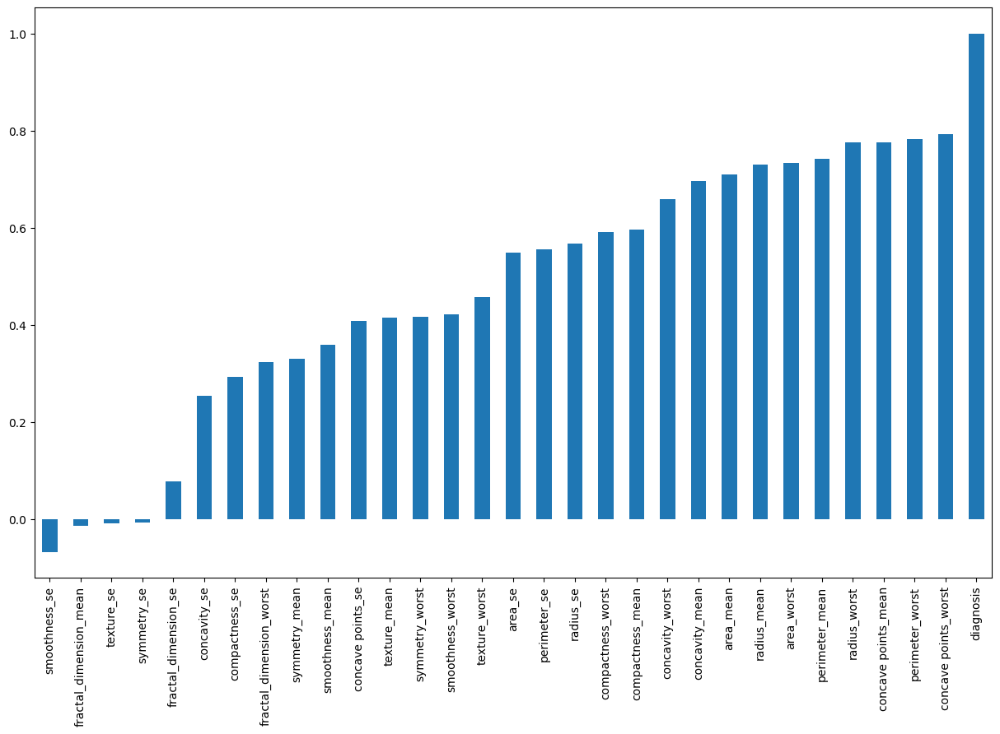

In [ ]:
import matplotlib.pyplot as plt


fig = plt.figure(figsize=(15,9), edgecolor= 'r')
df_data_processing.corr()['diagnosis'].sort_values(ascending=True).plot(kind='bar')
plt.show()

## Escalabilidad de los datos

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
scaler = MinMaxScaler()
df_data_processing_scaled = scaler.fit_transform(df_data_processing)

In [ ]:
df_data_processing_scaled = pd.DataFrame(df_data_processing_scaled)

In [ ]:
df_data_processing_scaled.columns = df_data_processing.columns

In [ ]:
df_data_processing_scaled.head(5)

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,diagnosis
0,0.521037,0.022658,0.545989,0.363733,0.593753,0.792037,0.703140,0.731113,0.686364,0.605518,...,0.141525,0.668310,0.450698,0.601136,0.619292,0.568610,0.912027,0.598462,0.418864,1.0
1,0.643144,0.272574,0.615783,0.501591,0.289880,0.181768,0.203608,0.348757,0.379798,0.141323,...,0.303571,0.539818,0.435214,0.347553,0.154563,0.192971,0.639175,0.233590,0.222878,1.0
2,0.601496,0.390260,0.595743,0.449417,0.514309,0.431017,0.462512,0.635686,0.509596,0.211247,...,0.360075,0.508442,0.374508,0.483590,0.385375,0.359744,0.835052,0.403706,0.213433,1.0
3,0.210090,0.360839,0.233501,0.102906,0.811321,0.811361,0.565604,0.522863,0.776263,1.000000,...,0.385928,0.241347,0.094008,0.915472,0.814012,0.548642,0.884880,1.000000,0.773711,1.0
4,0.629893,0.156578,0.630986,0.489290,0.430351,0.347893,0.463918,0.518390,0.378283,0.186816,...,0.123934,0.506948,0.341575,0.437364,0.172415,0.319489,0.558419,0.157500,0.142595,1.0


## Análisis exploratorio de datos

In [ ]:
import seaborn as sns

In [ ]:
def plot_categorical(column):
  fig = plt.figure(figsize=(5,5))
  sns.countplot(data=df_data, x=column, hue='diagnosis')
  plt.show()

In [ ]:
column_cat = df_data.select_dtypes(include='object').columns

In [ ]:
for _ in column_cat:
  plot_categorical(_)

In [ ]:
fig = plt.figure(figsize=(10,10))
sns.pairplot(data=df_data, hue= 'Churn')
plt.show()

<Figure size 1000x1000 with 0 Axes>

## Entrenamiento del modelo de regresión logística binomial

In [ ]:
x = df_data_processing_scaled.drop('diagnosis', axis=1)
y = df_data_processing_scaled['diagnosis'].values

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.25, random_state=42)

In [ ]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression()
result = model.fit(x_train, y_train)

In [ ]:
from sklearn import metrics
prediction_test = model.predict(x_test)
print(metrics.accuracy_score(y_test, prediction_test))

0.986013986013986


## Evaluación del modelo

In [ ]:
model.predict_proba(x_test)

array([[8.12140430e-01, 1.87859570e-01],
       [3.49087520e-02, 9.65091248e-01],
       [1.64018378e-01, 8.35981622e-01],
       [9.37203547e-01, 6.27964527e-02],
       [9.77540099e-01, 2.24599009e-02],
       [8.24318444e-05, 9.99917568e-01],
       [8.19747731e-04, 9.99180252e-01],
       [2.96512895e-01, 7.03487105e-01],
       [5.05089451e-01, 4.94910549e-01],
       [9.57155158e-01, 4.28448422e-02],
       [8.65210708e-01, 1.34789292e-01],
       [2.57607743e-01, 7.42392257e-01],
       [9.12012371e-01, 8.79876286e-02],
       [3.14535253e-01, 6.85464747e-01],
       [9.54609715e-01, 4.53902847e-02],
       [2.11773565e-02, 9.78822643e-01],
       [9.42023519e-01, 5.79764810e-02],
       [9.91980396e-01, 8.01960367e-03],
       [9.98292803e-01, 1.70719656e-03],
       [5.94922103e-03, 9.94050779e-01],
       [7.24711570e-01, 2.75288430e-01],
       [9.17194604e-01, 8.28053956e-02],
       [5.49393266e-04, 9.99450607e-01],
       [9.90543774e-01, 9.45622632e-03],
       [9.587894

In [ ]:
model.coef_

array([[ 1.69524495e+00,  1.63444782e+00,  1.65797796e+00,
         1.44606293e+00,  6.45305202e-01,  3.14551350e-01,
         1.32854289e+00,  2.02357863e+00,  4.72151806e-01,
        -8.19315499e-01,  1.14506027e+00,  2.27049017e-02,
         8.43911945e-01,  7.51914870e-01, -3.43908569e-04,
        -5.80822575e-01, -1.97104154e-01,  2.52577277e-01,
        -2.20703658e-01, -6.10980460e-01,  2.12915565e+00,
         2.22995797e+00,  1.90786200e+00,  1.53613365e+00,
         1.39016793e+00,  7.34113135e-01,  1.38745485e+00,
         2.46790346e+00,  1.37245338e+00,  2.57873192e-01]])

In [ ]:
model.feature_names_in_

array(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se',
       'smoothness_se', 'compactness_se', 'concavity_se',
       'concave points_se', 'symmetry_se', 'fractal_dimension_se',
       'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
       'smoothness_worst', 'compactness_worst', 'concavity_worst',
       'concave points_worst', 'symmetry_worst',
       'fractal_dimension_worst'], dtype=object)

Axes(0.125,0.11;0.775x0.77)


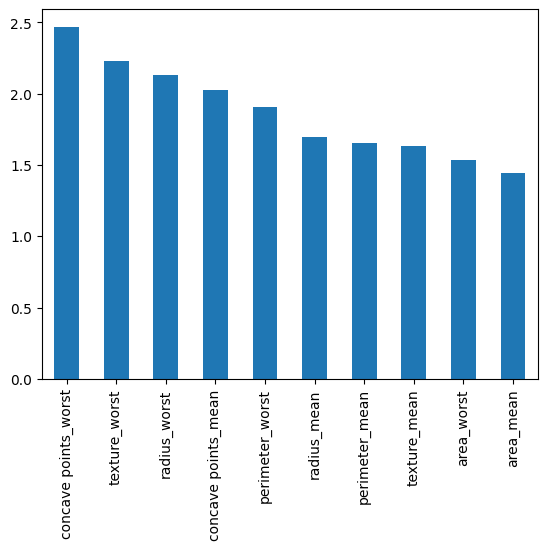

In [ ]:
weigths = pd.Series(model.coef_[0], index= x.columns.values)
print(weigths.sort_values(ascending=False)[:10].plot(kind='bar'))

In [ ]:

#Calculo de las predicciones en Train y Test
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

In [ ]:
#Calculo de metricas
from sklearn.metrics import accuracy_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print(f'El accuracy en train es {train_accuracy} y el accuracy en test es: {test_accuracy}')

El accuracy en train es 0.9671361502347418 y el accuracy en test es: 0.986013986013986


In [ ]:
#Funcion para comprobar individual

def comproIndv (data):
  datos_test = data.split()
  datos_test = [datos_test]
  columnas = ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst']
  data = pd.DataFrame(datos_test, columns=columnas)
  prediccion = model.predict_proba(data)
  respuesta_prediccion = f'La persona {"tiene cancer" if (prediccion[0][0] < prediccion[0][1]) else "no tiene cancer"}'
  return respuesta_prediccion

In [ ]:
#Pruebas
data_cruda = '0.521037	0.022658	0.545989	0.363733	0.593753	0.792037	0.70314	0.731113	0.686364	0.605518	0.356147	0.120469	0.369034	0.273811	0.159296	0.351398	0.135682	0.300625	0.311645	0.183042	0.620776	0.141525	0.66831	0.450698	0.601136	0.619292	0.56861	0.912027	0.598462	0.418864'
data_cruda_two = '0.259785	0.300643	0.257757	0.143542	0.424483	0.265076	0.187559	0.189911	0.436869	0.290017	0.10306	0.151123	0.081987	0.04387	0.178128	0.126611	0.068207	0.196439	0.139838	0.092976	0.250445	0.336354	0.227302	0.121092	0.471703	0.204238	0.213339	0.348797	0.28563	0.212908'

print(f'{comproIndv(data_cruda)} \n{comproIndv(data_cruda_two)}')


La persona tiene cancer 
La persona no tiene cancer
